# **1. Image Data Augmentation**

In [ ]:
!pip install tensorflow matplotlib numpy
!pip install keras_cv


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras_cv import layers as cv_layers
import matplotlib.pyplot as plt
import numpy as np

Using TensorFlow backend


# **Load and Display Original Image**

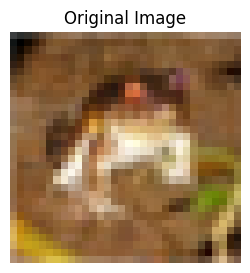

In [ ]:
from tensorflow.keras.datasets import cifar10
import matplotlib.pyplot as plt

# Load CIFAR-10 data
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

# Select an image to demonstrate augmentation
original_image = x_train[0]

import matplotlib.pyplot as plt

def display_image(image, title="Image"):
    plt.figure(figsize=(3, 3))  # Increase figure size for better visibility
    if image.ndim == 3 and image.shape[2] == 1:  # If the image has a single channel (grayscale)
        plt.imshow(image[:,:,0], cmap='gray')
    else:
        plt.imshow(image)
    plt.title(title)
    plt.axis('off')  # Turn off axis numbers and ticks
    plt.show()


# Display the original image
display_image(original_image, "Original Image")


# **Using ImageDataGenerator for Basic Augmentations**

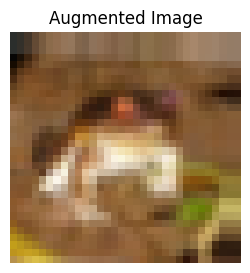

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np

# Create an ImageDataGenerator object with several augmentations
data_gen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Prepare the image for generating augmented examples
image_batch = np.expand_dims(original_image, axis=0)

# Generate a batch of augmented images
augmented_images = next(data_gen.flow(image_batch, batch_size=1))

# Display one of the augmented images
display_image(augmented_images[0].astype('uint8'), "Augmented Image")


# **Using keras_cv for Advanced Augmentations**

# **Using RandAugment**

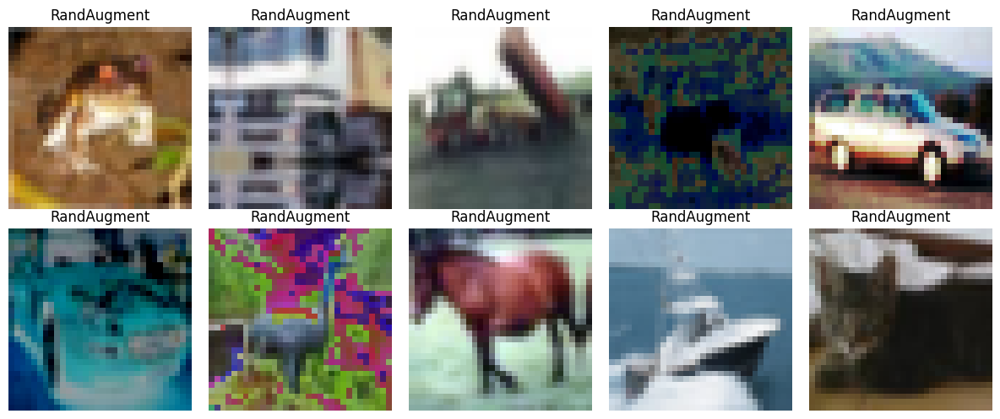

In [ ]:
import keras_cv
from tensorflow.keras.datasets import cifar10
import matplotlib.pyplot as plt
import numpy as np

# Load CIFAR-10 data
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

# Initialize RandAugment
rand_augment = keras_cv.layers.RandAugment(
    value_range=(0, 255),
    augmentations_per_image=3,
    magnitude=0.3,
    magnitude_stddev=0.2,
    rate=0.5
)

# Function to apply augmentation and visualize
def visualize_augmentations(images, titles, rows=2):
    plt.figure(figsize=(12, 5))
    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(rows, len(images) // rows, i + 1)
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Apply augmentation to a batch of images and visualize
batch_images = x_train[:10]  # Select the first 10 images
augmented_images = [rand_augment(img[np.newaxis, ...]).numpy().astype('uint8')[0] for img in batch_images]
visualize_augmentations(augmented_images, ['RandAugment'] * 10)


## **Using CutMix and MixUp**

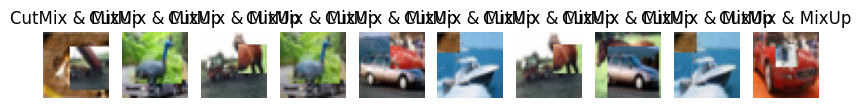

In [ ]:
import numpy as np

# Initialize CutMix and MixUp
cut_mix = keras_cv.layers.CutMix()
mix_up = keras_cv.layers.MixUp()

# Function to apply CutMix and MixUp
def apply_cutmix_and_mixup(images, labels):
    # Convert labels to float32 - this is important as CutMix expects float labels
    labels = labels.astype('float32')

    # Prepare inputs in the required dictionary format
    inputs = {"images": images, "labels": labels}

    # Apply CutMix
    outputs = cut_mix(inputs, training=True)
    # Apply MixUp
    outputs = mix_up(outputs, training=True)

    return outputs['images'], outputs['labels']

# Select a batch of images and labels (ensure your batch is correctly shaped)
batch_images = x_train[:10]  # This should be of shape (10, 32, 32, 3)
batch_labels = y_train[:10]

# Normalize the images if not already done
batch_images = batch_images.astype('float32') / 255.0

# Apply CutMix and MixUp
augmented_images, augmented_labels = apply_cutmix_and_mixup(batch_images, batch_labels)

# Ensure you have a function to visualize these augmentations
# Example function (modify according to your actual visualization code)
def visualize_augmentations(images, titles):
    plt.figure(figsize=(10, 2))
    for i, image in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        plt.imshow(image)
        plt.title(titles[i])
        plt.axis('off')
    plt.show()

# Visualize the augmentations
visualize_augmentations(augmented_images, ['CutMix & MixUp'] * 10)


## **Custom Augmentation Pipeline**

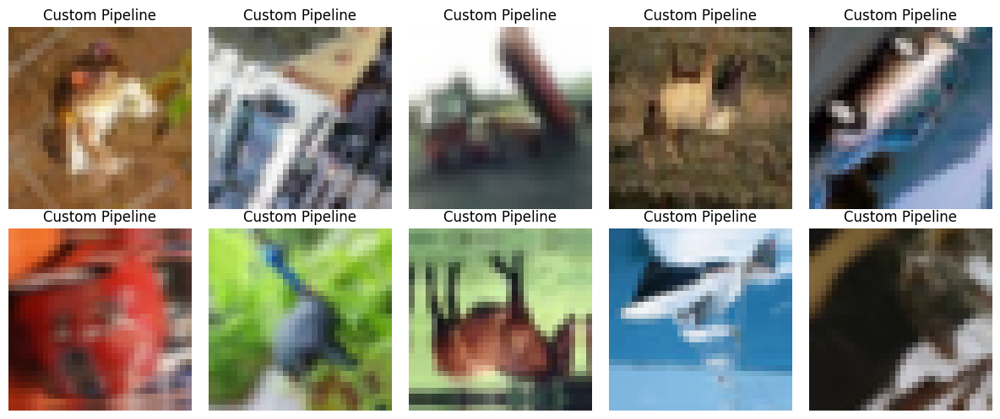

In [ ]:
# Define a pipeline with multiple augmentation layers
pipeline = keras_cv.layers.RandomAugmentationPipeline(
    layers=[
        keras_cv.layers.RandomFlip("horizontal_and_vertical"),
        keras_cv.layers.RandomRotation(factor=0.3),
        keras_cv.layers.RandomZoom(height_factor=0.2, width_factor=0.2)
    ],
    augmentations_per_image=2
)

# Apply the pipeline to images
augmented_images = [pipeline(img[np.newaxis, ...]).numpy().astype('uint8')[0] for img in batch_images]
visualize_augmentations(augmented_images, ['Custom Pipeline'] * 10)


# **Text Augmentation with nlpaug**

In [ ]:
!pip install nlpaug


In [ ]:
!pip install transformers


In [ ]:
import nlpaug.augmenter.word as naw

# Define some sample text
sample_text = "The quick brown fox jumps over the lazy dog."

# Initialize augmenters
syn_augmenter = naw.SynonymAug(aug_src='wordnet')
context_augmenter = naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action="insert")

# Apply augmentations
augmented_texts = {
    "Original": sample_text,
    "Synonym Replacement": syn_augmenter.augment(sample_text),
    "Contextual Insertion": context_augmenter.augment(sample_text)
}

# Print results
for desc, text in augmented_texts.items():
    print(f"{desc}: {text}\n")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Original: The quick brown fox jumps over the lazy dog.

Synonym Replacement: ['The quick brown dodger jumps all over the lazy wiener.']

Contextual Insertion: ['the tall quick brown fox jumps over to the lazy lazy dog.']



# **Video Augmentation**

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving elefant_1280p.mp4 to elefant_1280p.mp4
Saving giraffes_1280p.mp4 to giraffes_1280p.mp4


In [ ]:
import cv2
import numpy as np

def rotate_frame(frame, angle):
    """Rotate the frame by the specified angle."""
    height, width = frame.shape[:2]
    center = (width // 2, height // 2)
    matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(frame, matrix, (width, height))

def adjust_brightness(frame, value=30):
    """Increase the brightness of the frame by a certain value."""
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value
    final_hsv = cv2.merge((h, s, v))
    frame = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return frame

def apply_zoom(frame, zoom_factor=1.1):
    """Apply zoom to the middle of the frame."""
    height, width = frame.shape[:2]
    new_height, new_width = int(height / zoom_factor), int(width / zoom_factor)
    start_row, start_col = (height - new_height) // 2, (width - new_width) // 2
    cropped_frame = frame[start_row:start_row + new_height, start_col:start_col + new_width]
    return cv2.resize(cropped_frame, (width, height))


In [ ]:
def process_video(input_filename, output_filename):
    cap = cv2.VideoCapture(input_filename)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = None

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Apply augmentations
        frame = rotate_frame(frame, angle=10)
        frame = adjust_brightness(frame, value=40)
        frame = apply_zoom(frame, zoom_factor=1.2)

        if out is None:
            height, width = frame.shape[:2]
            out = cv2.VideoWriter(output_filename, fourcc, 20.0, (width, height))

        out.write(frame)

    cap.release()
    out.release()

# Apply the process to both videos
process_video('elefant_1280p.mp4', 'augmented_elephant_1280p.mp4')
process_video('giraffes_1280p.mp4', 'augmented_giraffes_1280p.mp4')


In [ ]:
from IPython.display import HTML
from base64 import b64encode

def display_video(path):
    mp4 = open(path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML("""
    <video width=400 controls>
        <source src="%s" type="video/mp4">
    </video>
    """ % data_url)

# Display the augmented videos
display_video('augmented_elephant_1280p.mp4')
display_video('augmented_giraffes_1280p.mp4')


In [ ]:
from google.colab import files

# Download the augmented videos
files.download('augmented_elephant_1280p.mp4')
files.download('augmented_giraffes_1280p.mp4')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **Time-Series Data Augmentation**

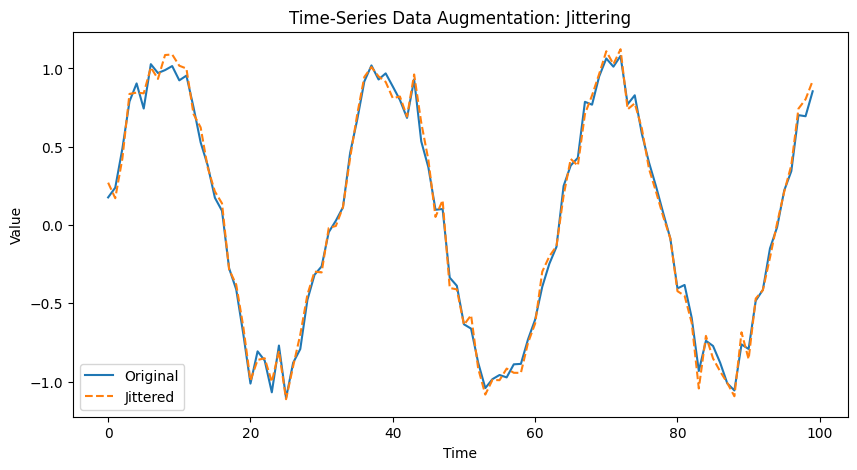

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Generate synthetic time-series data
np.random.seed(0)
time_series = np.sin(0.2 * np.arange(100)) + np.random.normal(scale=0.1, size=100)

def jitter_time_series(data, sigma=0.05):
    """Apply jittering to the time-series data."""
    noise = np.random.normal(scale=sigma, size=data.shape)
    return data + noise

# Augment the time-series data
augmented_time_series = jitter_time_series(time_series)

# Plot the original and augmented data
plt.figure(figsize=(10, 5))
plt.plot(time_series, label='Original')
plt.plot(augmented_time_series, label='Jittered', linestyle='--')
plt.title('Time-Series Data Augmentation: Jittering')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.show()


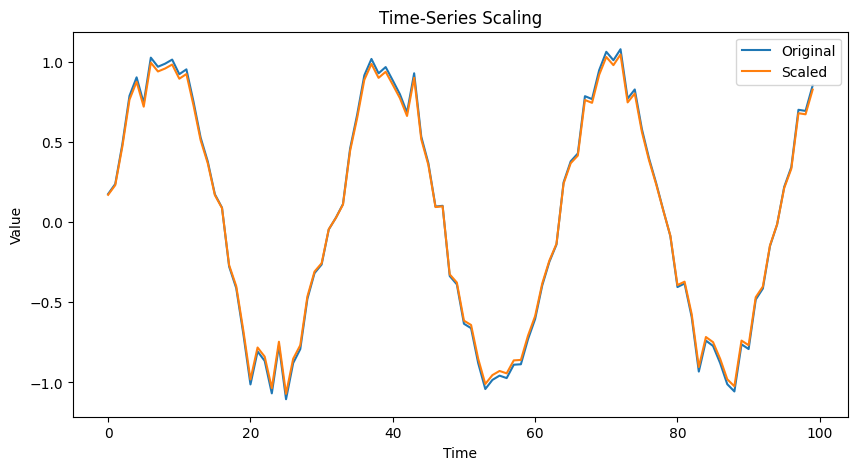

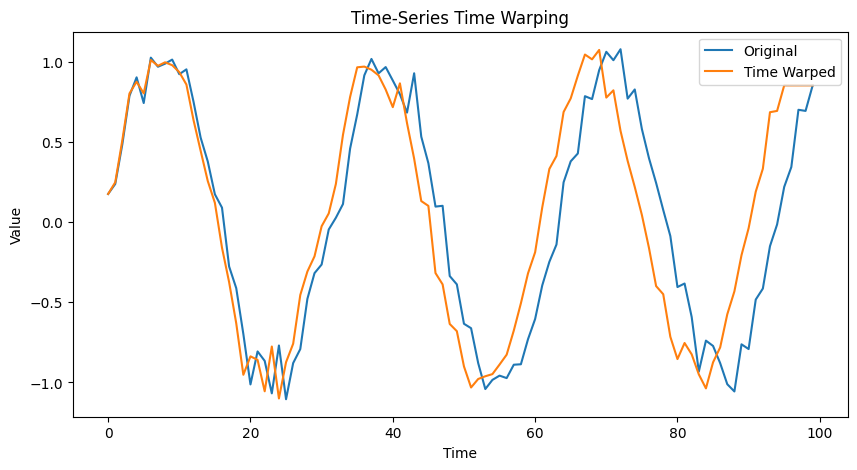

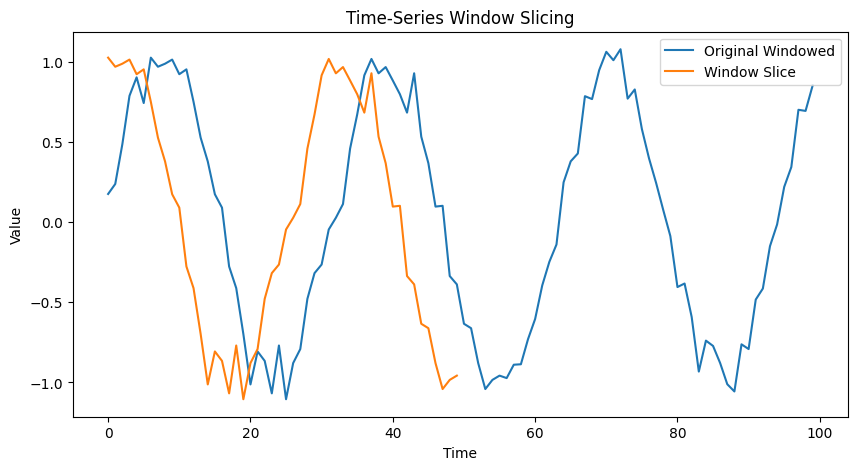

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Helper function to plot time-series data
def plot_time_series(data, labels, title):
    plt.figure(figsize=(10, 5))
    for series, label in zip(data, labels):
        plt.plot(series, label=label)
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

# Generate synthetic time-series data
np.random.seed(0)
time_series = np.sin(0.2 * np.arange(100)) + np.random.normal(scale=0.1, size=100)

# Scaling
def scale_time_series(data, scale_range=(0.8, 1.2)):
    scale = np.random.uniform(scale_range[0], scale_range[1])
    return data * scale

# Time Warping
def time_warp_time_series(data, warping_factor=(0.8, 1.2)):
    time_points = np.arange(len(data))
    time_points = np.interp(time_points, np.linspace(0, len(data), num=len(data)),
                            np.linspace(0, len(data) * np.random.uniform(*warping_factor), num=len(data)))
    return np.interp(time_points, np.arange(len(data)), data)

# Window Slicing
def window_slicing_time_series(data, window_size=50):
    start = np.random.randint(0, len(data) - window_size)
    return data[start:start + window_size]

# Apply augmentations
scaled_series = scale_time_series(time_series)
warped_series = time_warp_time_series(time_series)
windowed_series = window_slicing_time_series(time_series)

# Plotting the results
plot_time_series([time_series, scaled_series], ['Original', 'Scaled'], 'Time-Series Scaling')
plot_time_series([time_series, warped_series], ['Original', 'Time Warped'], 'Time-Series Time Warping')
plot_time_series([time_series, windowed_series], ['Original Windowed', 'Window Slice'], 'Time-Series Window Slicing')


# **augment tabular data**

In [ ]:
import numpy as np
import pandas as pd

# Assuming df is your DataFrame and 'feature1' is a numerical column
def add_noise(data, feature, noise_level=0.01):
    noise = noise_level * np.random.randn(len(data))
    data[feature] += noise
    return data

# Example DataFrame
data = {'feature1': np.random.normal(size=100), 'feature2': np.random.normal(size=100)}
df = pd.DataFrame(data)

# Apply noise
df_noised = add_noise(df.copy(), 'feature1', noise_level=0.1)
print(df_noised.head())


   feature1  feature2
0  1.070675  0.492759
1 -1.382306  0.090113
2  0.773772 -0.997568
3 -1.504964 -0.800038
4 -1.227673  0.207076


In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification

# Generate a sample dataset
X, y = make_classification(n_classes=2, class_sep=2, weights=[0.1, 0.9], n_informative=3, n_redundant=1, flip_y=0,
                           n_features=20, n_clusters_per_class=1, n_samples=1000, random_state=10)

# SMOTE
smote = SMOTE(sampling_strategy='minority')
X_sm, y_sm = smote.fit_resample(X, y)

print('Original dataset shape', len(y))
print('Resampled dataset shape', len(y_sm))


Original dataset shape 1000
Resampled dataset shape 1800


In [ ]:
def random_permutation(data, feature):
    data[feature] = np.random.permutation(data[feature])
    return data

# Apply random permutation
df_permuted = random_permutation(df.copy(), 'feature1')
print(df_permuted.head())


   feature1  feature2
0 -0.928159  0.492759
1  0.298772  0.090113
2  0.403186 -0.997568
3 -0.209129 -0.800038
4 -1.762039  0.207076


In [ ]:
# Apply noise
df_augmented = add_noise(df.copy(), 'feature1', noise_level=0.05)

# Apply SMOTE
smote = SMOTE(sampling_strategy='minority')
X = df_augmented[['feature1', 'feature2']]
y = np.random.randint(0, 2, df_augmented.shape[0])  # Dummy target variable
X_sm, y_sm = smote.fit_resample(X, y)

# Convert back to DataFrame
df_augmented = pd.DataFrame(X_sm, columns=['feature1', 'feature2'])
df_augmented['target'] = y_sm

# Apply permutation
df_augmented = random_permutation(df_augmented, 'feature2')

print(df_augmented.head())


   feature1  feature2  target
0  1.142206 -0.184351       1
1 -1.320234 -0.672785       1
2  0.909979 -0.728058       1
3 -1.468532 -1.159206       0
4 -0.967247  0.839516       0


# **Speech Data Augmentation**

In [ ]:
!pip install torchaudio


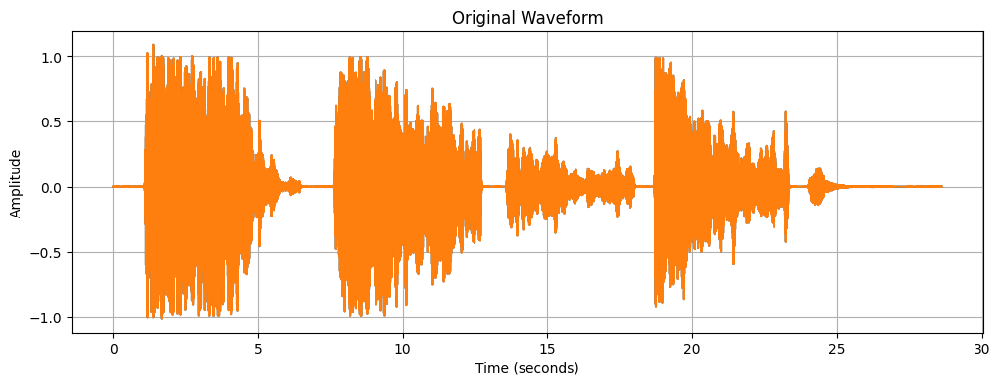

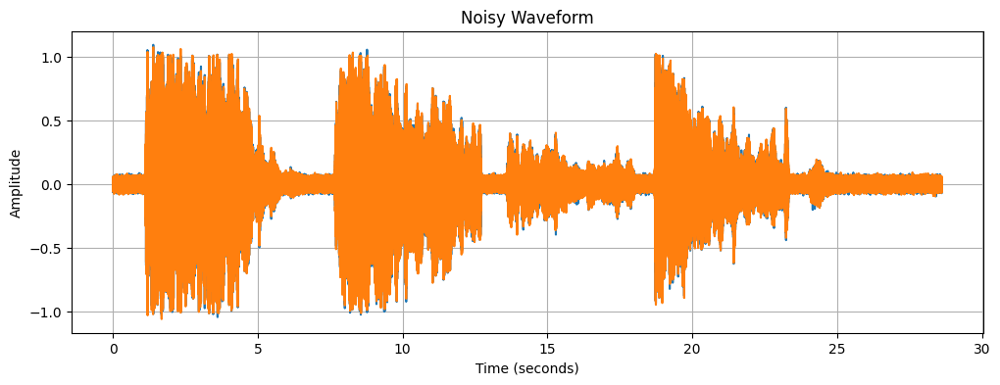

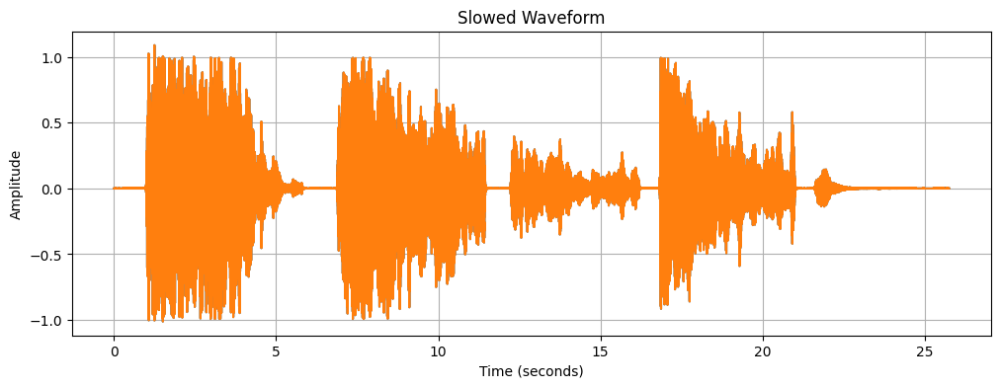

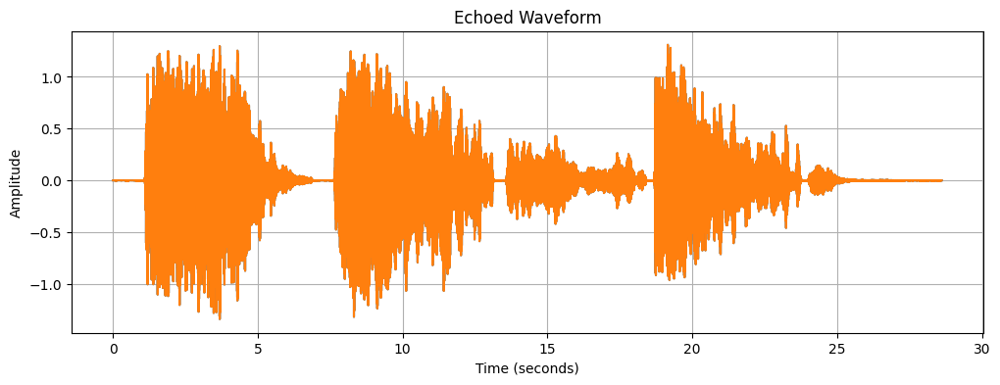

In [ ]:
import torch
import torchaudio
import torchaudio.transforms as T
import matplotlib.pyplot as plt

def add_echo(waveform, sample_rate, delay_ms=400, decay=0.6):
    delay_samples = int(sample_rate * delay_ms / 1000)
    echo_waveform = torch.zeros_like(waveform)
    echo_waveform[:, delay_samples:] = decay * waveform[:, :-delay_samples]
    return waveform + echo_waveform

def plot_waveform(waveform, sample_rate, title="Waveform"):
    time_axis = torch.arange(0, waveform.size(1)) / sample_rate
    plt.figure(figsize=(12, 4))
    plt.plot(time_axis, waveform.t().numpy())
    plt.title(title)
    plt.ylabel('Amplitude')
    plt.xlabel('Time (seconds)')
    plt.grid(True)
    plt.show()

# Upload the file to Colab first using the GUI, then use the correct filename here
file_path = '/content/my_bariton.m4a'  # Adjust the path as necessary
waveform, sample_rate = torchaudio.load(file_path, normalize=True)

# Adding noise
noise = torch.randn(waveform.size()) * 0.02
noisy_waveform = waveform + noise

# Changing speed (0.9x speed)
speed_transform = T.Resample(sample_rate, int(sample_rate * 0.9))
slow_waveform = speed_transform(waveform)

# Adding echo
echo_waveform = add_echo(waveform, sample_rate, delay_ms=400, decay=0.6)

# Plotting the original and augmented waveforms
plot_waveform(waveform, sample_rate, title="Original Waveform")
plot_waveform(noisy_waveform, sample_rate, title="Noisy Waveform")
plot_waveform(slow_waveform, sample_rate, title="Slowed Waveform")
plot_waveform(echo_waveform, sample_rate, title="Echoed Waveform")


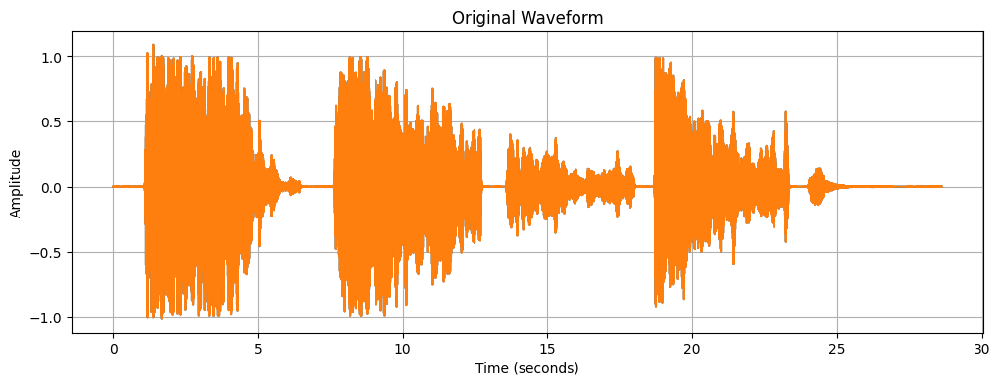

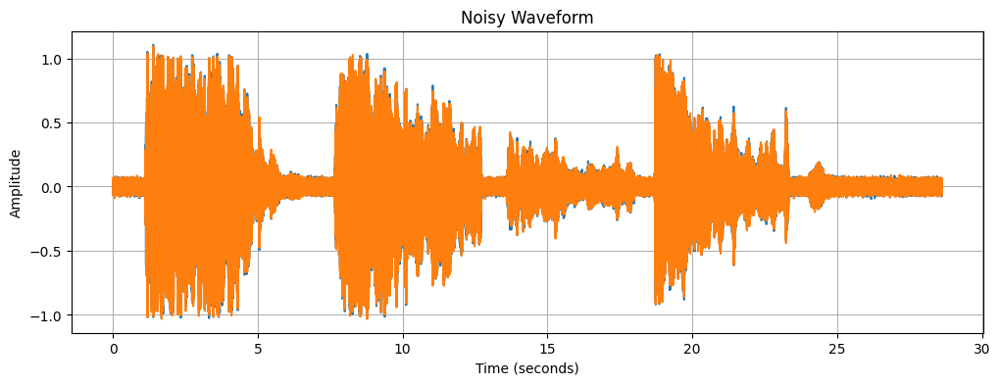

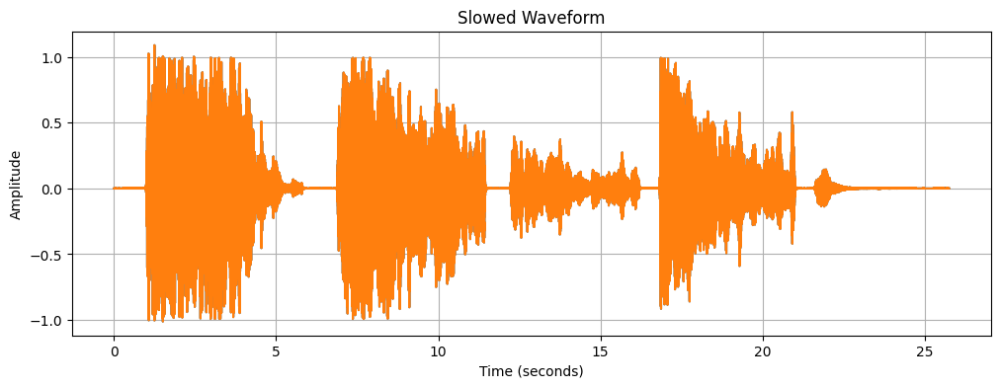

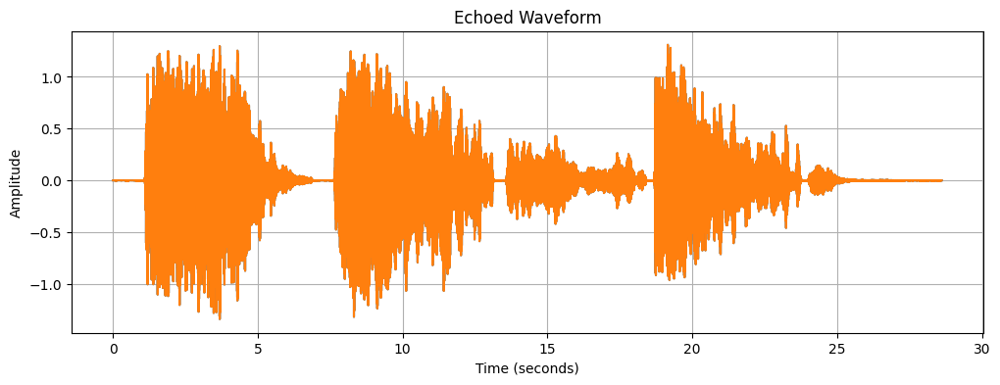

In [ ]:
import torch
import torchaudio
import torchaudio.transforms as T
import matplotlib.pyplot as plt
from IPython.display import Audio

def add_echo_playable(waveform, sample_rate, delay_ms=400, decay=0.6):
    delay_samples = int(sample_rate * delay_ms / 1000)
    echo_waveform = torch.zeros_like(waveform)
    echo_waveform[:, delay_samples:] = decay * waveform[:, :-delay_samples]
    return waveform + echo_waveform

def plot_and_play(waveform, sample_rate, title="Waveform"):
    # Plot waveform
    time_axis = torch.arange(0, waveform.size(1)) / sample_rate
    plt.figure(figsize=(12, 4))
    plt.plot(time_axis, waveform.t().numpy())
    plt.title(title)
    plt.ylabel('Amplitude')
    plt.xlabel('Time (seconds)')
    plt.grid(True)
    plt.show()
    # Play audio
    display(Audio(waveform.numpy(), rate=sample_rate))

# Load your audio file
file_path = '/content/my_bariton.m4a'  # Adjust the path as necessary
waveform, sample_rate = torchaudio.load(file_path, normalize=True)

# Adding noise
noise = torch.randn(waveform.size()) * 0.02
noisy_waveform = waveform + noise

# Changing speed (0.9x speed)
speed_transform = T.Resample(sample_rate, int(sample_rate * 0.9))
slow_waveform = speed_transform(waveform)

# Adding echo
echo_waveform = add_echo_playable(waveform, sample_rate, delay_ms=400, decay=0.6)

# Plotting and playing the original and augmented waveforms
plot_and_play(waveform, sample_rate, title="Original Waveform")
plot_and_play(noisy_waveform, sample_rate, title="Noisy Waveform")
plot_and_play(slow_waveform, sample_rate, title="Slowed Waveform")
plot_and_play(echo_waveform, sample_rate, title="Echoed Waveform")


# **Document Augmentation**

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Activity diagram.png to Activity diagram (1).png


In [ ]:
!pip install augly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.3/24.3 MB 33.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31532 sha256=d36667a1b8d348a05bad7105363bf0e557f113e1f511c36555bb5387dd363952
  Stored in directory: /root/.cache/pip/wheels/9a/a3/b6/ac0fcd1b4ed5cfeb3db92e6a0e476cfd48ed0df92b91080c1d
Successfully built iopath


In [ ]:
import augly.image as imaugs
print(dir(imaugs))


['ApplyLambda', 'ApplyPILFilter', 'Blur', 'Brightness', 'ChangeAspectRatio', 'ClipImageSize', 'ColorJitter', 'Compose', 'Contrast', 'ConvertColor', 'Crop', 'EncodingQuality', 'Grayscale', 'HFlip', 'MaskedComposite', 'MemeFormat', 'OneOf', 'Opacity', 'OverlayEmoji', 'OverlayImage', 'OverlayOntoBackgroundImage', 'OverlayOntoScreenshot', 'OverlayStripes', 'OverlayText', 'Pad', 'PadSquare', 'PerspectiveTransform', 'Pixelization', 'RandomAspectRatio', 'RandomBlur', 'RandomBrightness', 'RandomEmojiOverlay', 'RandomNoise', 'RandomPixelization', 'RandomRotation', 'Resize', 'Rotate', 'Saturation', 'Scale', 'Sharpen', 'ShufflePixels', 'Skew', 'VFlip', '__all__', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__path__', '__spec__', 'apply_lambda', 'apply_lambda_intensity', 'apply_pil_filter', 'apply_pil_filter_intensity', 'aug_np_wrapper', 'blur', 'blur_intensity', 'brightness', 'brightness_intensity', 'change_aspect_ratio', 'change_aspect_ratio_int

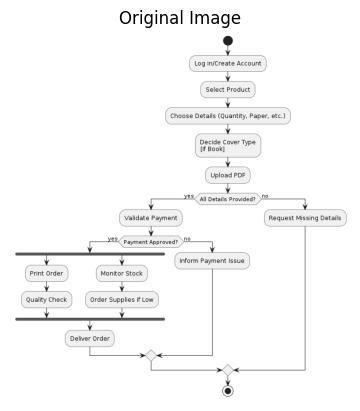

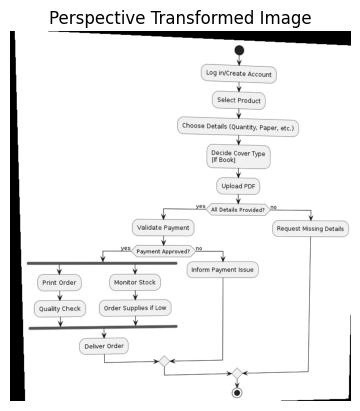

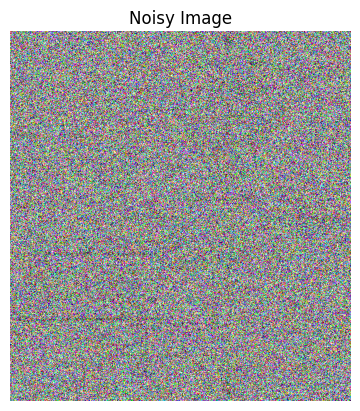

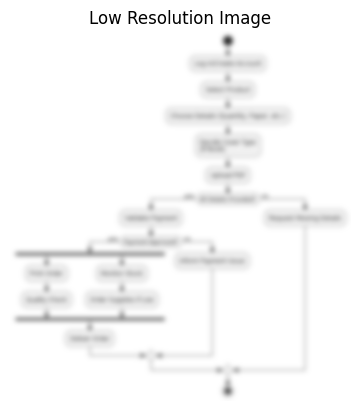

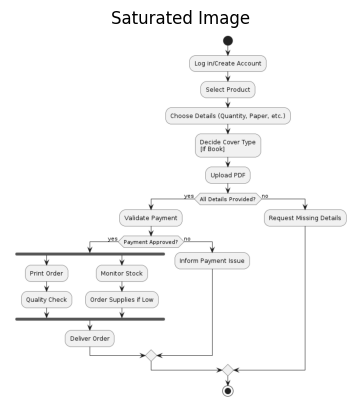

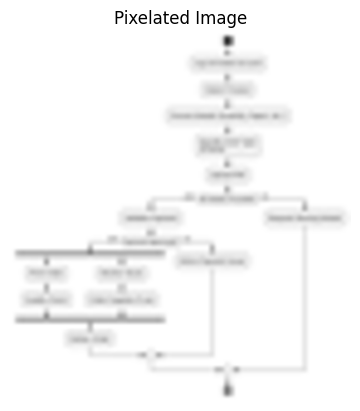

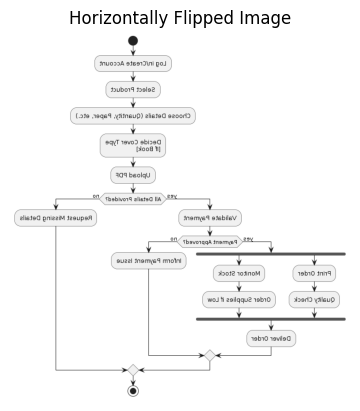

In [ ]:
import augly.image as imaugs
from PIL import Image
import matplotlib.pyplot as plt

def display_image(image, title):
    plt.figure()
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load and display the image
image_path = 'Activity diagram.png'  # Ensure this is correctly set after uploading to Colab
image = Image.open(image_path)

# Apply a perspective transform
transformed = imaugs.perspective_transform(image, sigma=20)

# Add noise
noisy = imaugs.random_noise(image, mean=0, var=10)  # Adjust mean and variance if needed

# Simulate a low-resolution scan using blur
low_res = imaugs.blur(image, radius=5)

# Increase saturation
saturated = imaugs.saturation(image, factor=2.0)  # Increase saturation by a factor of 2

# Apply pixelization
pixelated = imaugs.pixelization(image, ratio=0.1)  # Pixelate by reducing image resolution by 90%

# Horizontal flip
flipped = imaugs.hflip(image)

# Display the original and augmented images
display_image(image, "Original Image")
display_image(transformed, "Perspective Transformed Image")
display_image(noisy, "Noisy Image")
display_image(low_res, "Low Resolution Image")
display_image(saturated, "Saturated Image")
display_image(pixelated, "Pixelated Image")
display_image(flipped, "Horizontally Flipped Image")
